# Audio Processing Lab 4: 3D Audio
Gizem Tabak

We will create dynamic 3D audio, which, when played back on headphones, sounds like it comes from a specific direction (spatial audio) as opposed to inside of our head.

In [ ]:
#@title Import packages
%matplotlib inline
import scipy.signal as sgn
import scipy.io.wavfile as wv
import matplotlib.pyplot as plt
import numpy as np
import IPython
from matplotlib import mlab as mlab
from os.path import join

plt.rcParams["figure.figsize"] = (10, 6)

## Part 1: Static sources using ITD/ILD cues

We will start with a static source. It will sound like it is coming from an intended direction, which does not change over time.

- $\theta:$ Source location with respect to the center of the head (degrees)
- $d_{\text{head}}:$ Horizontal distance between two ears (meters)

Given $\theta$ and $d_{\text{head}}$, I first calculated the difference between the paths $(d)$ from the source to the left and right ears. If $\theta > 0$, it means the source is on the left and $d>0$. If $\theta < 0$, it means the source is on the right and $d<0$. Then, I calculated the attenuation factor of the contralateral ear by interpolating the factor from $1$ to $0.7$ for $\theta=0$ and $|\theta|=90$. For the sources behind the head ($\theta > 90$), I used $180 - \theta$ for the interpolation instead of $\theta$ to calculate the attenuation factor. Using $\theta > 90$ does not make sense because the attenuation difference between two ears should be less as the source gets closer to the medial plane. I applied the attenuation to the corresponding ear based on $\text{sign}(d)$.

In [ ]:
#@title Code to generate ILT/ITDs for a given source location
def generate_filters(theta, d_head, fs):
    # theta in radians
    theta_rad = theta*np.pi/180.
    v = 343. # speed of sound
    # distance from the source to the left ear
    d_left = np.sqrt((2*np.cos(theta_rad))**2 + (2*np.sin(theta_rad) - d_head/2.)**2)
    # distance from the source to the right ear
    d_right = np.sqrt((2*np.cos(theta_rad))**2 + (2*np.sin(theta_rad) + d_head/2.)**2)
    # print('d_l ', d_left)
    # print('d_r ', d_right)
    d = d_right - d_left
    t_d = d/v # delay (sec)
    n_d = int(abs(t_d) * fs) # delay (taps)
    a_d = 1. - abs(min(theta, 180 - theta))*(0.3/90.)
    h_left = np.zeros(n_d+1)
    h_right = np.zeros(n_d+1)
    if t_d >= 0:
        h_left[0] = 1.
        h_right[n_d] = a_d
    else:
        h_right[0] = 1.
        h_left[n_d] = a_d
        
    return h_left, h_right    

In [ ]:
#@title Code to plot filter responses
def plot_fir_response(filter1, filter2, fs):
    nTaps = len(filter1)
    w, h = sgn.freqz(filter1)

    plt.figure()
    plt.subplot(221)
    plt.stem(np.arange(nTaps), filter1)
    plt.ylabel('Amplitude')
    plt.title('FIR impulse response')
    plt.grid()

    ax1 = plt.subplot(222)
    plt.title('FIR frequency response')
    ax1.plot((w/np.pi)*fs/2, 20 * np.log10(abs(h)), 'b')
    ax2 = ax1.twinx()
    angles = np.unwrap(np.angle(h))
    ax2.plot((w/np.pi)*fs/2, angles, 'g')
    ax2.set_ylabel('Angle (radians)', color='g')
    ax2.grid()
    ax2.axis('tight')
    ax1.legend(['Amplitude'], loc=0, framealpha=0)
    ax2.legend(['Phase'], bbox_to_anchor=(0.418, 0., 0.5, 0.9), framealpha=0)
    
    w2, h2 = sgn.freqz(filter2)
    nTaps2 = len(filter2)
    plt.subplot(223)
    plt.stem(np.arange(nTaps2), filter2)
    plt.xlabel('Taps')
    plt.ylabel('Amplitude')
    plt.grid()

    ax1 = plt.subplot(224)
    ax1.plot((w2/np.pi)*fs/2, 20 * np.log10(abs(h2)), 'b')
    ax1.set_xlabel('Frequency [Hz]')
    ax2 = ax1.twinx()
    angles = np.unwrap(np.angle(h2))
    ax2.plot((w2/np.pi)*fs/2, angles, 'g')
    ax2.set_ylabel('Angle (radians)', color='g')
    ax2.grid()
    ax2.axis('tight')
    
    ax1.legend(['Amplitude'], loc=0, framealpha=0)
    ax2.legend(['Phase'], bbox_to_anchor=(0.418, 0., 0.5, 0.9), framealpha=0)
    plt.show()

In [ ]:
#@title Code to apply ITD/ILDs
def play_itd_ild(s, h_left, h_right, fs):
    s_left = sgn.convolve(s, h_left)
    s_right = sgn.convolve(s, h_right)
    s_itd_ild = np.vstack((s_left, s_right))
    # plt.subplot(121)
    # plt.specgram(s_left, NFFT=256, Fs=fs_fly, window=np.hanning(256), 
    #          noverlap=128)
    # plt.subplot(122)
    # plt.specgram(s_left, NFFT=256, Fs=fs_fly, window=np.hanning(256), 
    #          noverlap=128)
    # plt.ylabel('Freq (Hz)')
    # plt.xlabel('Time (sec)')
    # plt.colorbar()
    # plt.show()
    IPython.display.display( IPython.display.Audio( s_itd_ild, rate=fs))

When the source is straight ahead, there is no change in the signal. This is clearly expected by looking at the responses of the filters, which imply no delay and no attenuation.

44100 44100 44100
Original - Fly


Original - Helicopter


Original - Crumble


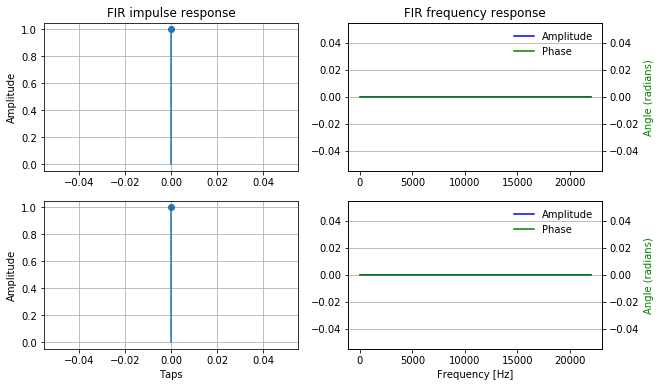

Straight ahead - Fly


Straight ahead - Helicopter


Straight ahead - Crumble


In [ ]:
d_head = 0.25
fs_fly, fly        = wv.read('data/fly.wav')
fs_hc,  helicopter = wv.read('data/helicopter.wav')
fs_cr,  crumble    = wv.read('data/crumble.wav')
print(fs_fly, fs_hc, fs_cr)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
theta = 0
h_left, h_right = generate_filters(theta, d_head, fs_fly)
plot_fir_response(h_left, h_right, fs_fly)
print('Straight ahead - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('Straight ahead - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('Straight ahead - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

When I change $\theta$ to 45 degrees, the response of the filter for the left ear stays the same, without any delay or attenuation. It means it does not affect the original signal. However, the filter for the right ear delays and attenuates the signal and hence, the combined stereo sound sounds like it is coming from the left, although it is hard to understand that it is coming exactly from 45 degrees.

In [ ]:
theta = 45
h_left, h_right = generate_filters(theta, d_head, fs_fly)
plot_fir_response(h_left, h_right, fs_fly)
print('45 degrees to the left - Fly')
play_itd_ild(fly, h_left, h_right, fs_fly)
print('45 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_fly)
print('45 degrees to the left - Crumble')
play_itd_ild(crumble, h_left, h_right, fs_fly)

For this case, the delay is 31 filter taps, and the attenuation is close to 0.7; which are more than the previous case since the difference of the distance of the source to the ears is increased. This time, it sounds like the source is on the right. Although it feels like slightly closer to my shoulder than to my forehead, the angle of arrival is not obvious beyond saying it is on the right.

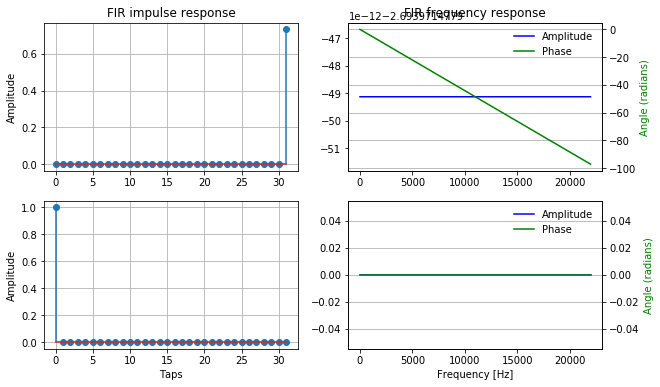

80 degrees to the right - Fly


80 degrees to the right - Helicopter


80 degrees to the right - Crumble


In [ ]:
theta = -80
h_left, h_right = generate_filters(theta, d_head, fs_fly)
plot_fir_response(h_left, h_right, fs_fly)
print('80 degrees to the right - Fly')
play_itd_ild(fly, h_left, h_right, fs_fly)
print('80 degrees to the right - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_fly)
print('80 degrees to the right - Crumble')
play_itd_ild(crumble, h_left, h_right, fs_fly)

In this case,  it still sounds like the source is on the left. However, the delay and the attenuation is much smaller compared to the second case where the sound is coming from 45 degrees to the left. Hence, the direction of the source is not as obvious. It sounds more like somewhere between the front and slightly left. 

Although 160 degrees to the left corresponds to the back of the head, the sound is not perceived as it is coming from the back. In fact, it sounds (and seems) identical to the case where the sound is coming from 20 degrees to the left (see the 20 degrees to the left case below). This is an example of two opposing points on a cone of confusion.

In [ ]:
theta = 160
h_left, h_right = generate_filters(theta, d_head, fs_fly)
plot_fir_response(h_left, h_right, fs_fly)
print('160 degrees to the left - Fly')
play_itd_ild(fly, h_left, h_right, fs_fly)
print('160 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_fly)
print('160 degrees to the left - Crumble')
play_itd_ild(crumble, h_left, h_right, fs_fly)

In [ ]:
theta = 20
h_left, h_right = generate_filters(theta, d_head, fs_fly)
plot_fir_response(h_left, h_right, fs_fly)
print('20 degrees to the left - Fly')
play_itd_ild(fly, h_left, h_right, fs_fly)
print('20 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_fly)
print('20 degrees to the left - Crumble')
play_itd_ild(crumble, h_left, h_right, fs_fly)

## Part 2: Static sources using HRTFs

In Part 1, the filters for left and right channels were just single tap filters with modified amplitudes and delays. Hence, they were not frequency selective, and the effect of the filters on all 3 of the sounds were the same. In this case, we will use head-related transfer functions. These are personalized filters that represent how our head (shape of our ears, facial bones and tissues, our head, skull, torso, etc.) affect the sound we hear. 

Compared to the previous section, the HRTF responses are much more complex. They have nonlinear phase, are frequency selective and have longer impulse response. As it can be seen below, the input sounds have relatively uniform spectrum, especially over the lower frequency range (0-15kHz). This means as a result of using HRTF filters, we can hear the sound as if the source is outside of the head and it reflects the effects of head-related modifications on the sound.

I changed the code so that for each elevation, it will retrieve the corresponding azimuth increment and get the nearest available filter response for that given azimuth and elevation. For 40 degree azimuth, the elevations were so irrelevant that I could not automatically load the corresponding HRTFs. Hence I used 30 instead of 40 degree azimuth.

In [ ]:
#@title Helper function to load HRTF file for a given position
def load_hrtf( ad, ed):
    # Return the HRTFs for a given azimuth and elevation
    #  function h,a,e = load_hrtf( ad, ed)
    #
    # Inputs:
    #   ad  is the azimuth to use in degrees (0 is front)
    #   ed  is the elevation to use in degrees (0 is level with ears)
    #
    # Output:
    #   l,r two 128pt arrays, first is left ear HRTF, second is right ear HRTF
    import numpy as np
    # Path where the HRTFs are
    p = 'hrtf/compact/'

    # Get nearest available elevation
    e = max( -40, min( 90, 10*(ed//10)))
    
    # 
    ad_incr = {-10: 5, -20: 5, -30: 6, -40: 6.6, 0:5, 10:5, 20:5, 30:6, 40:6.66, 50:8, 60: 10, 70: 15, 80: 30, 90: 0}

    # Get nearest available azimuth
    ad = np.remainder( ad, 360)
    if ad > 180:
        ad = ad-360
    if ad < 0:
        a = abs( ad)
        fl = 1
    else:
        a = ad
        fl = 0

    if e == 90:
        a = 0
    elif e == 40:
        e = 30
        a = max( 0, min( 180, ad_incr[e]*(a//ad_incr[e])))
    else:
        a = max( 0, min( 180, ad_incr[e]*(a//ad_incr[e])))   
            
    # Load appropriate response

    h = np.fromfile( '%s/elev%d/H%de%.3da.dat' % (p, e, e, a), dtype='>i2').astype( 'double')/32768

    if fl:
        return h[1::2],h[::2]
    else:
        return h[::2],h[1::2]


Compared to the previous section, the HRTF responses are much more complex. They have nonlinear phase, are frequency selective and have longer impulse response. As it can be seen below, the input sounds have relatively uniform spectrum, especially over the lower frequency range (0-15kHz). This means as a result of using HRTF filters, we can hear the sound as if the source is outside of the head and it reflects the effects of head-related modifications on the sound.

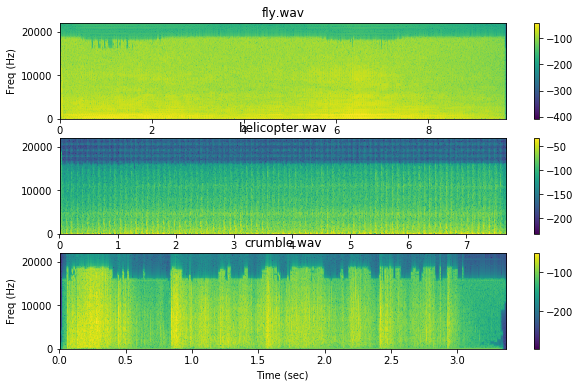

In [ ]:
plt.subplot(311)
plt.specgram(fly, NFFT=256, Fs=fs_fly, window=np.hanning(256), 
             noverlap=128, cmap='viridis')
plt.title('fly.wav')
plt.ylabel('Freq (Hz)')
plt.colorbar()
plt.subplot(312)
plt.specgram(helicopter, NFFT=256, Fs=fs_fly, window=np.hanning(256), 
             noverlap=128, cmap='viridis')
plt.title('helicopter.wav')
plt.colorbar()
plt.subplot(313)
plt.specgram(crumble, NFFT=256, Fs=fs_fly, window=np.hanning(256), 
             noverlap=128, cmap='viridis')
plt.title('crumble.wav')
plt.xlabel('Time (sec)')
plt.ylabel('Freq (Hz)')
plt.colorbar()
plt.show()

In this case where the source is straight ahead, the filters that correspond to the left and the right side have the same response. As a result, two ears hear the exact same sound and hence it sounds like the sources are straight ahead. Although they both sound like the source is straight ahead, the previous recordings in Part 1 and these do not sound _exactly_ the same. HRTF ones sound as if they are coming from a distance.

In [ ]:
ad = 0
ed = 0
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
print('Straight ahead - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('Straight ahead - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('Straight ahead - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

I tried changing the elevation while keeping azimuth the same. Although there is not an obvious difference, it sounds like the sound is coming from a slightly deeper or maybe further place.

In [ ]:
ad = 0
ed = 45
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
print('45 degrees above - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('45 degrees above - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('45 degrees above - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

In this case, it sounds like the source is on the left. Compared to ITD/ILD cues, using HRTFs makes it sound more natural and rich. Again, the sound is more like coming from a distance rather than directly from the left side of my head, as a result of the nonuniform spectrum of the HRTFs.

In [ ]:
ad = -45
ed = 0
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
print('45 degrees to the left - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('45 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('45 degrees to the left - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

In this case, the difference between the clips generated with ITD/ILD cues and HRTFs is more clear. HRTF-generated clips sound much more distant and rich. Also, the difference between 45 and 80 degrees are more pronounced compared to two sets of clips generated with ITD/ILD cues. This means localization is better with HRTFs, as expected.

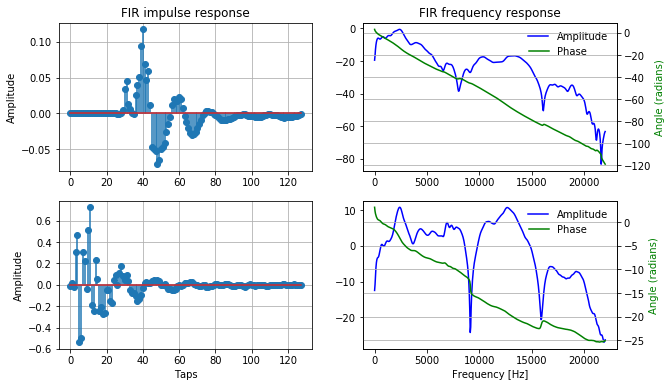

Original - Fly


Original - Helicopter


Original - Crumble


80 degrees to the right - Fly


80 degrees to the right - Helicopter


80 degrees to the right - Crumble


In [ ]:
ad = 80
ed = 0
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
print('80 degrees to the right - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('80 degrees to the right - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('80 degrees to the right - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

In this case, the clips are much more different than the ones generated with ITD/ILD cues. It actually sounds like the source is behind me on the left, rather than in front. Looking at the filter responses, amplitudes are lower than previous cases for both ears, probably due to the effect of the head, and also because our ears face forward. As opposed to ITD/ILD cues, there seems to be no cone of confusion; 20 degree to the left sounds and looks much more different than 160 degrees to the left.

In [ ]:
ad = -160
ed = 0
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('Original - Fly')
IPython.display.display( IPython.display.Audio( fly, rate=fs_fly))
print('Original - Helicopter')
IPython.display.display( IPython.display.Audio( helicopter, rate=fs_hc))
print('Original - Crumble')
IPython.display.display( IPython.display.Audio( crumble   , rate=fs_cr))
print('160 degrees to the left - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('160 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('160 degrees to the left - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

ad = -20
ed = 0
h_left, h_right = load_hrtf( ad, ed)
plot_fir_response(h_left, h_right, fs_fly)
print('20 degrees to the left - Fly')
play_itd_ild(fly,        h_left, h_right, fs_fly)
print('20 degrees to the left - Helicopter')
play_itd_ild(helicopter, h_left, h_right, fs_hc)
print('20 degrees to the left - Crumble')
play_itd_ild(crumble   , h_left, h_right, fs_cr)

Looking at all the filter responses for HRTFs, there is a decreasing trend of the amplitude in the spectrum over frequency. Higher frequencies seem to be attenuated more than lower frequencies in general. This is consistent with our hearing experience and also with the fact that higher frequencies attenuate more travelling through air and tissues.

The notches around 9kHz and 16kHz are also consistent among all the HRTFs. These might be the result of the shape of our ears.

## Part 3: Dynamic Sources

Now, we will implement a source that moves around in 3D space!

I modified the STFT code from the first lab so that at each iteration, it gets a chunk of the input signal, pads it with equal amount of zeros, loads HRTFs that corresponds to that iteration's azimuth and elevation, so that by the end of the signal, the source would have made a full circle, starting from below the head and going above. 

First, I updated the HRTF load function to upload the closest HRTF for a given position. Then, I modified the STFT code I wrote for Lab 1 such that at each iteration, it will load the corresponding position's HRTF, get a chunk of input signal with the same size as HRTF filters, pads both with equal amount of zeros to avoid circular convolution, take DFT, and multiply them to form, at the end, a STFT matrix for the sound each ear will hear.

Note that in the code below, the actual DFT size is `dft_size + zero_pad`, where `dft_size` corresponds to the length of the signal whose DFT we want to get.

In [ ]:
h_left, h_right = load_hrtf( 0, 0)
filter_size = len(h_left)
zero_pad = filter_size
hop_size = filter_size
window = []

fly_stft_left_output, fly_stft_right_output = dynamic_stft(fly, filter_size, hop_size, zero_pad, window)
fly_idft_left  = dynamic_stft( fly_stft_left_output, filter_size, hop_size, zero_pad, window)
fly_idft_right = dynamic_stft( fly_stft_right_output, filter_size, hop_size, zero_pad, window)

fly_idft = np.vstack((fly_idft_left, fly_idft_right))
IPython.display.display( IPython.display.Audio( fly_idft, rate=fs_fly))

In [ ]:
#@title Helper function that implements dynamic STFT
def dynamic_stft( input_sound, dft_size, hop_size, zero_pad, window):
    if len(np.shape(input_sound)) == 1:
        # Forward transform
        input_sound_padded = np.zeros(len(input_sound) + dft_size + hop_size - len(input_sound)%hop_size)
        input_sound_padded[:len(input_sound)] = input_sound
        L = len(input_sound_padded) -  dft_size
        stft_left_output = np.zeros([int((dft_size + zero_pad)/2) + 1, int(L/hop_size)], dtype=complex)
        stft_right_output = np.zeros([int((dft_size + zero_pad)/2) + 1, int(L/hop_size)], dtype=complex)
        ad = np.linspace(0, 360, int(L/hop_size))
        ed = np.linspace(-40, 90, int(L/hop_size))
        for i in range(0, int(L/hop_size)):
            seg = input_sound_padded[(i*hop_size):(i*hop_size + dft_size)]
            # Choose and apply window if selected
            if window == 'triangular':
                seg = np.multiply(seg, np.bartlett(dft_size))
            elif window == 'hanning':
                seg = np.multiply(seg, np.hanning(dft_size))
            elif window == 'hamming':
                seg = np.multiply(seg, np.hamming(dft_size))
            elif window == 'kaiser':
                seg = np.multiply(seg, np.kaiser(dft_size, beta=0.8))
            # Change size variable so that it will pad zeros to input    
            s_stft = np.fft.rfft(seg, dft_size + zero_pad)
            
            h_left, h_right = load_hrtf( ad[i], ed[i] )
                
            h_left_padded = np.zeros(dft_size + zero_pad)
            h_left_padded[:filter_size] = h_left
            h_right_padded = np.zeros(dft_size + zero_pad)
            h_right_padded[:filter_size] = h_right
            
            stft_left_output[:,i] = s_stft * np.fft.rfft(h_left_padded, dft_size + zero_pad)
            stft_right_output[:,i] = s_stft * np.fft.rfft(h_right_padded, dft_size + zero_pad)
        # X = np.arange(0, (int(L/hop_size)*hop_size)/fs, hop_size/fs)
        # Y = np.arange(0, fs/2, fs/(2*(int((dft_size + zero_pad)/2) + 1)))
        # # Make zero elements equal to the smallest value to avoid log(0) for plotting
        # min_nonzero = np.min(stft_output[np.nonzero(stft_output)])
        # stft_output[stft_output == 0] = min_nonzero
        # 
        # plt.pcolormesh(X, Y, 20*np.log10(np.abs(stft_output)))
        # plt.xlabel('Time (sec)')
        # plt.ylabel('Freq (Hz)')
        # plt.title('DFT=%d HOP=%d PAD=%d WINDOW=%s' %(dft_size, hop_size, zero_pad, window))
# 
        # plt.show()
        return stft_left_output, stft_right_output
    elif len(np.shape(input_sound)) == 2:
        # Inverse transform
        L = (np.shape(input_sound)[1]+1)*hop_size
        stft_output = np.zeros([int(L)+hop_size,])
        for i in range(0, int((L - dft_size - zero_pad)/hop_size)):
            s_stft = np.fft.irfft(input_sound[:,i], dft_size+zero_pad)
            if len(window) > 0:
                # Window should only cover nonzero part, not zero paddings
                if window == 'triangular':
                    w = np.bartlett(dft_size)
                elif window == 'hanning':
                    w = np.hanning(dft_size)
                elif window == 'hamming':
                    w = np.hamming(dft_size)
                elif window == 'kaiser':
                    w = np.kaiser(dft_size, beta=0.8)
                # Pad window with zeros to make dimensions equal
                window_padded = np.concatenate([w, np.zeros([zero_pad,])])
                s_stft = np.multiply(s_stft, window_padded)
            # Overlap and add
            stft_output[i*hop_size:(i*hop_size + dft_size + zero_pad)] += s_stft
        
        return stft_output

## Part 4: 

We have an audio file that contains various sound effects. Using those, we want to generate a story. The file includes segments of a person walking, one that sounds like a door opening, one with a roar and a cough, one with a gun, two liquid dripping sound and one liquid stream sound.

In [ ]:
#@title Code to display audio snippets
fs_dry, dry        = wv.read('data/dry.wav')
print(fs_dry, np.shape(dry))
IPython.display.display( IPython.display.Audio( dry[:,0], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,1], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,2], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,3], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,4], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,5], rate=fs_dry))
IPython.display.display( IPython.display.Audio( dry[:,6], rate=fs_dry))
plt.subplot(241)
plt.plot(dry[:,0])
plt.title('Walking')
plt.grid()
plt.subplot(242)
plt.plot(dry[:,1])
plt.title('Door')
plt.grid()
plt.subplot(243)
plt.plot(dry[:,2])
plt.title('Roar/Cough')
plt.grid()
plt.subplot(244)
plt.plot(dry[:,3])
plt.title('Gun')
plt.grid()
plt.subplot(245)
plt.plot(dry[:,4])
plt.title('Drops-1')
plt.grid()
plt.subplot(246)
plt.plot(dry[:,5])
plt.title('Drops-2')
plt.grid()
plt.subplot(247)
plt.plot(dry[:,6])
plt.title('Stream')
plt.grid()
plt.show()

I decided to construct a story such that someone will open the door, which is located on the left side of the room, and walks in through the door to the center of the room. Then, they will encounter a roaring animal coming from the right side, gets shocked, pulls out a gun and starts shooting in the middle of the room. The animal gets shot and then it will turn into an old, coughing women for some reason. While all these happening, there are subtle water drops on the right side closer to the ground and water is streaming from right to left. And the room is actually a church. Because why not.

In [ ]:
fs_church, church = wv.read('data/standrews.wav')
# Downsample library RIR 
secs = len(church)/fs_church # Number of seconds in signal
samps = int(secs*fs_dry)
church_ds = sgn.resample(church, samps)

I modified the STFT code such that it will take the input sound clip and the movement of the source from one point in time and location to another. Movement of the source is encoded as 2 azimuth and elevation vectors, and assumed linear in time and space between these two points. Then, I generated the responses of moving sources. In order to shorten processing time and to be able to change the order of the sound occurences, I clipped the parts I need from each audio channel and then applied HRTFs.
After applying HRTFs, I combined all seven channels together for left and right ears. Then, I convolved these with the room impulse response of the church we used in the previous lab. Instead of convolution, I could use STFT bu that required modifying the STFT function so that it will have the option to use RIR instead of HRTFs. Since I was just going to use convolution once for each ear, I refrained from changing the function.

In [ ]:
#@title Helper function for moving sources aroung
def move_sources( input_sound, from_az, to_az, from_el, to_el):
    # from_az[0]: time (samples) when the horizontal movement starts 
    # from_az[1]: location (degrees) when the horizontal movement starts
    # to_az[0]: time (samples) when the horizontal movement stops 
    # to_az[1]: location (degrees) when the horizontal movement stops
    # from_el[0]: time (samples) when the vertical movement starts 
    # from_el[1]: location (degrees) when the vertical movement starts
    # to_el[0]: time (samples) when the vertical movement stops 
    # to_el[1]: location (degrees) when the vertical movement stops
    h_left, h_right = load_hrtf( 0, 0)
    dft_size = len(h_left)
    zero_pad = dft_size
    hop_size = dft_size
    if len(np.shape(input_sound)) == 1:
        # Forward transform
        input_sound_padded = np.zeros(len(input_sound) + dft_size + hop_size - len(input_sound)%hop_size)
        input_sound_padded[:len(input_sound)] = input_sound
        L = len(input_sound_padded) -  dft_size
        stft_left_output = np.zeros([int((dft_size + zero_pad)/2) + 1, int(L/hop_size)], dtype=complex)
        stft_right_output = np.zeros([int((dft_size + zero_pad)/2) + 1, int(L/hop_size)], dtype=complex)
        ad = np.zeros(int(L/hop_size))
        ed = np.zeros(int(L/hop_size))
        ad_move = np.linspace(from_az[1], to_az[1], int((to_az[0] - from_az[0])/hop_size))
        ed_move = np.linspace(from_el[1], to_el[1], int((to_el[0] - from_el[0])/hop_size))
        ad[(from_az[0]//hop_size):((from_az[0]//hop_size)+len(ad_move))] = ad_move
        ed[(from_el[0]//hop_size):((from_el[0]//hop_size)+len(ed_move))] = ed_move
        for i in range(0, int(L/hop_size)):
            seg = input_sound_padded[(i*hop_size):(i*hop_size + dft_size)]
            # Change size variable so that it will pad zeros to input    
            s_stft = np.fft.rfft(seg, dft_size + zero_pad)
            
            h_left, h_right = load_hrtf( ad[i], ed[i] )
                
            h_left_padded = np.zeros(dft_size + zero_pad)
            h_left_padded[:filter_size] = h_left
            h_right_padded = np.zeros(dft_size + zero_pad)
            h_right_padded[:filter_size] = h_right
            
            stft_left_output[:,i] = s_stft * np.fft.rfft(h_left_padded, dft_size + zero_pad)
            stft_right_output[:,i] = s_stft * np.fft.rfft(h_right_padded, dft_size + zero_pad)

        return stft_left_output, stft_right_output
    elif len(np.shape(input_sound)) == 2:
        # Inverse transform
        L = (np.shape(input_sound)[1]+1)*hop_size
        stft_output = np.zeros([int(L)+hop_size,])
        for i in range(0, int((L - dft_size - zero_pad)/hop_size)):
            s_stft = np.fft.irfft(input_sound[:,i], dft_size+zero_pad)
            # Overlap and add
            stft_output[i*hop_size:(i*hop_size + dft_size + zero_pad)] += s_stft
        
        return stft_output

The segment below extracts audio effects from the file manually and puts them back together in the desired order with the intended movement effects. 
Parts of the code is manual and ugly, lots of room for improvement.


In [ ]:
#@title Code 
steps_start = 0
steps_end = 200000
l = len(dry[steps_start:steps_end,0])
steps_stft_left_output, steps_stft_right_output = move_sources( dry[steps_start:steps_end,0], [0, -60], [l, 0], [0,0], [l, 0])
steps_dynamic_left  = move_sources( steps_stft_left_output,  [0, -60], [l, 0], [0,0], [l, 0])
steps_dynamic_right = move_sources( steps_stft_right_output, [0, -60], [l, 0], [0,0], [l, 0])
s_all = np.vstack((steps_dynamic_left, steps_dynamic_right))

door_start = 199000
door_end = 300000
door_stft_left_output, door_stft_right_output = move_sources( dry[door_start:door_end,1], [0, -60], [len(dry[door_start:door_end,1]), -60], [0,0], [len(dry[door_start:door_end,1]), 0])
door_dynamic_left  = move_sources( door_stft_left_output, [0, -60], [len(dry[door_start:door_end,1]), -60], [0,0], [len(dry[door_start:door_end,1]), 0])
door_dynamic_right = move_sources( door_stft_right_output, [0, -60], [len(dry[door_start:door_end,1]), -60], [0,0], [len(dry[door_start:door_end,1]), 0])
s_all = np.vstack((door_dynamic_left, door_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

roar_start = 280000
roar_end = 410000
from_az = [0, 60]
to_az   = [l, 30]
from_el = [0, 0]
to_el   = [l, 0]
l = len(dry[roar_start:roar_end,2])
roar_stft_left_output, roar_stft_right_output = move_sources( dry[roar_start:roar_end,2], from_az, to_az, from_el, to_el)
roar_dynamic_left  = move_sources( roar_stft_left_output,  from_az, to_az, from_el, to_el)
roar_dynamic_right = move_sources( roar_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((roar_dynamic_left, roar_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

cough_start = 450000
cough_end = len(dry[:,2])
l = len(dry[cough_start:,2])
from_az = [0, 15]
to_az   = [l, 45]
from_el = [0, 0]
to_el   = [l, -30]
cough_stft_left_output, cough_stft_right_output = move_sources( dry[cough_start:,2], from_az, to_az, from_el, to_el)
cough_dynamic_left  = move_sources( cough_stft_left_output,  from_az, to_az, from_el, to_el)
cough_dynamic_right = move_sources( cough_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((cough_dynamic_left, cough_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

gun_start = 320000
gun_end = 550000
l = len(dry[gun_start:gun_end,3])
from_az = [0, 0]
to_az   = [l, 30]
from_el = [0, 0]
to_el   = [l, 0]
gun_stft_left_output, gun_stft_right_output = move_sources( dry[gun_start:gun_end,3], from_az, to_az, from_el, to_el)
gun_dynamic_left  = move_sources( gun_stft_left_output,  from_az, to_az, from_el, to_el)
gun_dynamic_right = move_sources( gun_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((gun_dynamic_left, gun_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

drops1_start = 0
drops1_end = len(dry[:,4])
l = len(dry[drops1_start:drops1_end,4])
from_az = [0, 120]
to_az   = [l, 120]
from_el = [0, -20]
to_el   = [l, -20]
drops1_stft_left_output, drops1_stft_right_output = move_sources( dry[drops1_start:drops1_end,4], from_az, to_az, from_el, to_el)
drops1_dynamic_left  = move_sources( drops1_stft_left_output,  from_az, to_az, from_el, to_el)
drops1_dynamic_right = move_sources( drops1_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((drops1_dynamic_left, drops1_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

drops2_start = 0
drops2_end = len(dry[:,5])
l = len(dry[drops1_start:drops1_end,5])
from_az = [0, 120]
to_az   = [l, 120]
from_el = [0, -20]
to_el   = [l, -20]
drops2_stft_left_output, drops2_stft_right_output = move_sources( dry[drops2_start:drops2_end,5], from_az, to_az, from_el, to_el)
drops2_dynamic_left  = move_sources( drops2_stft_left_output,  from_az, to_az, from_el, to_el)
drops2_dynamic_right = move_sources( drops2_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((drops2_dynamic_left, drops2_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

stream_start = 0
stream_end = len(dry[:,6])
l = len(dry[stream_start:stream_end,6])
from_az = [0, 120]
to_az   = [l, -120]
from_el = [0, -20]
to_el   = [l, -20]
stream_stft_left_output, stream_stft_right_output = move_sources( dry[stream_start:stream_end,6], from_az, to_az, from_el, to_el)
stream_dynamic_left  = move_sources( stream_stft_left_output,  from_az, to_az, from_el, to_el)
stream_dynamic_right = move_sources( stream_stft_right_output, from_az, to_az, from_el, to_el)
s_all = np.vstack((stream_dynamic_left, stream_dynamic_right))
# IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))

dynamic_right_padded = np.zeros(len(drops1_dynamic_right))
dynamic_left_padded = np.zeros(len(drops1_dynamic_left))
L_door = 0
dynamic_left_padded[L_door:(L_door+len(door_dynamic_left))] += door_dynamic_left
dynamic_right_padded[L_door:(L_door+len(door_dynamic_right))] += door_dynamic_right
L_steps = len(door_dynamic_left)
dynamic_left_padded[L_steps:(len(steps_dynamic_left)+L_steps)] += steps_dynamic_left
dynamic_right_padded[L_steps:(L_steps+len(steps_dynamic_right))] += steps_dynamic_right
L_roar = (len(steps_dynamic_left)+len(door_dynamic_left) - len(roar_dynamic_left))
dynamic_left_padded[L_roar:(L_roar+len(roar_dynamic_left))] += roar_dynamic_left
dynamic_right_padded[L_roar:(L_roar+len(roar_dynamic_right))] += roar_dynamic_right
L_gun = L_roar + len(roar_dynamic_left)
dynamic_left_padded[L_gun:(L_gun+ len(gun_dynamic_left))]  += gun_dynamic_left
dynamic_right_padded[L_gun:(L_gun+len(gun_dynamic_right))] += gun_dynamic_right
L_cough = L_gun + len(gun_dynamic_right)//2 + 10000
dynamic_left_padded[L_cough:(L_cough+ len(cough_dynamic_left))]  += cough_dynamic_left
dynamic_right_padded[L_cough:(L_cough+len(cough_dynamic_right))] += cough_dynamic_right

dynamic_right_padded += 0.3*drops1_dynamic_right + \
                        0.3*drops2_dynamic_right + \
                        0.3*stream_dynamic_right
dynamic_left_padded  += 0.3*drops1_dynamic_left + \
                        0.3*drops2_dynamic_left + \
                        0.3*stream_dynamic_left

Finally, I combined all the sounds together, and added some church effects to jazz it up.

In [ ]:
s_all_left  = np.convolve(dynamic_left_padded, church[:,0])
s_all_right = np.convolve(dynamic_right_padded, church[:,1])
s_all = np.vstack((s_all_left, s_all_right))
IPython.display.display( IPython.display.Audio( s_all, rate=fs_dry))